# Multimodalidad en espacios vectoriales: Text, Audio, Image

### Prepared by: [Miguel Murillo]

---

# **Exploración de Embeddings Multimodales con CLIP y CLAP**  

Este **notebook** demuestra el uso de **OpenCLIP y CLAP** para representar imágenes, texto y audio en un **espacio latente compartido**, permitiendo comparaciones y búsquedas semánticas entre diferentes modalidades.  

## **Tecnologías Utilizadas**  
- **OpenCLIP**: Implementación abierta de CLIP para generación de embeddings de texto e imagen.  
- **CLAP (Contrastive Language-Audio Pretraining)**: Modelo que alinea audio y texto en un espacio latente compartido.  
- **ChromaDB**: Base de datos vectorial para almacenar y recuperar embeddings.   
- **Torch + Torchaudio**: Procesamiento de audio y extracción de características.  
- **SentenceTransformers**: Modelo de embeddings optimizado para texto.  

## **Casos de Uso**  
- **Búsqueda Multimodal**: Recuperar imágenes o audios basados en descripciones de texto.  
- **Análisis de Similaridad**: Comparación entre diferentes tipos de datos.  
- **Indexación Semántica**: Organización y recuperación eficiente de información en bases de datos vectoriales.
- **Clasificación Multimodal**: Asignación automática de etiquetas a imágenes, texto o audio mediante embeddings en un espacio latente compartido.


**Recomendaciones:**  
- Usar **re-rankers** o afinamiento si se requiere más precisión.  
- Evaluar eficiencia, ya que estos modelos pueden ser costosos en inferencia.  
- Combinarlos con bases de datos vectoriales como **ChromaDB** optimiza búsquedas.  

**Limitaciones:**  
- No capturan completamente contexto específico sin fine-tuning.  
- CLAP tiene limitaciones en audios complejos o de baja calidad.  
- OpenCLIP a veces pierde precisión en datos fuera de distribución.  

---

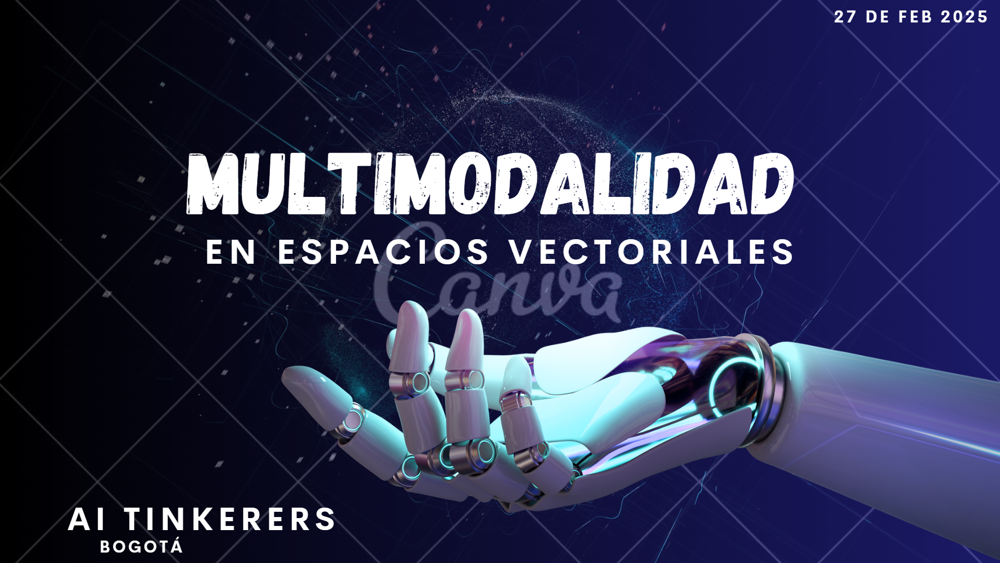

In [2]:
from PIL import Image
from IPython.display import display

img = Image.open("start.png")
display(img)

Installing dependencies

In [ ]:
%%capture
!pip install chromadb
!pip install datasets
!pip install pyarrow
!pip install open-clip-torch
!pip install sentence-transformers
!pip install langchain_core langchain_openai

In [ ]:
import IPython
from IPython.display import HTML, display, Image, Markdown, Video, Audio
from typing import Optional, Sequence, List, Dict, Union

import soundfile as sf

from langchain_openai import ChatOpenAI
from langchain_core.prompts import ChatPromptTemplate
from langchain_core.output_parsers import StrOutputParser

from google.colab import userdata

from sentence_transformers import SentenceTransformer
from transformers import ClapModel, ClapProcessor
from datasets import load_dataset

import chromadb
from chromadb.utils.embedding_functions import OpenCLIPEmbeddingFunction
from chromadb.utils.data_loaders import ImageLoader
from chromadb.api.types import Document, Embedding, EmbeddingFunction, URI, DataLoader

import numpy as np
import torchaudio
import base64
import torch
import json
import cv2
import os

In [ ]:
def set_css():
  display(HTML('''
  <style>
    pre {
        white-space: pre-wrap;
    }
  </style>
  '''))
get_ipython().events.register('pre_run_cell', set_css)

---

# Instantiate ChromaDB


In [ ]:
path = "mm_vdb"
client = chromadb.PersistentClient(path=path)

---

# Modality 1: Audio Retrieval



We'll be using the [esc50 Dataset](https://github.com/karolpiczak/ESC-50)

<img src="https://i.imgur.com/6lqmd8H.png" width=600>

## Load the Dataset

In [ ]:
ds = load_dataset("ashraq/esc50")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/345 [00:00<?, ?B/s]

Repo card metadata block was not found. Setting CardData to empty.


dataset_infos.json:   0%|          | 0.00/1.61k [00:00<?, ?B/s]

(…)-00000-of-00002-2f1ab7b824ec751f.parquet:   0%|          | 0.00/387M [00:00<?, ?B/s]

(…)-00001-of-00002-27425e5c1846b494.parquet:   0%|          | 0.00/387M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/2000 [00:00<?, ? examples/s]

## Saving Audio Files Locally


In [ ]:
# Define the directory to save audio files
path = "esc50"
os.makedirs(path, exist_ok=True)

# Process and save audio files
for item in ds['train']:
    audio_array = item['audio']['array']
    sample_rate = item['audio']['sampling_rate']
    file_name = item['filename']
    target_path = os.path.join(path, file_name)

    # Write the audio file to the new directory
    sf.write(target_path, audio_array, sample_rate)

print("All audio files have been processed and saved.")

All audio files have been processed and saved.


## Custom Data Loader




In [ ]:
class AudioLoader(DataLoader[List[Optional[Dict[str, any]]]]):
    def __init__(self, target_sample_rate: int = 48000) -> None:
        self.target_sample_rate = target_sample_rate

    def _load_audio(self, uri: Optional[URI]) -> Optional[Dict[str, any]]:
        if uri is None:
            return None

        try:
            waveform, sample_rate = torchaudio.load(uri)

            # Resample if necessary
            if sample_rate != self.target_sample_rate:
                resampler = torchaudio.transforms.Resample(sample_rate, self.target_sample_rate)
                waveform = resampler(waveform)

            # Convert to mono if stereo
            if waveform.shape[0] > 1:
                waveform = torch.mean(waveform, dim=0, keepdim=True)

            return {"waveform": waveform.squeeze(), "uri": uri}
        except Exception as e:
            print(f"Error loading audio file {uri}: {str(e)}")
            return None

    def __call__(self, uris: Sequence[Optional[URI]]) -> List[Optional[Dict[str, any]]]:
        return [self._load_audio(uri) for uri in uris]

## Custom Embedding Function

<img src="https://i.imgur.com/UyhMvUY.png" width=300>

The recent LAION CLAP model, available on [GitHub](https://github.com/LAION-AI/CLAP)

In [ ]:
class CLAPEmbeddingFunction(EmbeddingFunction[Union[Document, Dict[str, any]]]):
    def __init__(
        self,
        model_name: str = "laion/larger_clap_general",
        device: str = None
    ) -> None:
        if device is None:
            device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model = ClapModel.from_pretrained(model_name).to(device)
        self.processor = ClapProcessor.from_pretrained(model_name)
        self.device = device

    def _encode_audio(self, audio: torch.Tensor) -> Embedding:
        inputs = self.processor(audios=audio.numpy(), sampling_rate=48000, return_tensors="pt")
        inputs = {k: v.to(self.device) for k, v in inputs.items()}
        with torch.no_grad():
            audio_embedding = self.model.get_audio_features(**inputs)
        return audio_embedding.squeeze().cpu().numpy().tolist()

    def _encode_text(self, text: Document) -> Embedding:
        inputs = self.processor(text=text, return_tensors="pt")
        inputs = {k: v.to(self.device) for k, v in inputs.items()}
        with torch.no_grad():
            text_embedding = self.model.get_text_features(**inputs)
        return text_embedding.squeeze().cpu().numpy().tolist()

    def __call__(self, input: Union[List[Document], List[Optional[Dict[str, any]]]]) -> List[Optional[Embedding]]:
        embeddings = []
        for item in input:
            if isinstance(item, dict) and 'waveform' in item:
                embeddings.append(self._encode_audio(item['waveform']))
            elif isinstance(item, str):
                embeddings.append(self._encode_text(item))
            elif item is None:
                embeddings.append(None)
            else:
                raise ValueError(f"Unsupported input type: {type(item)}")
        return embeddings

## Creating Audio Collection Within Chroma


In [ ]:
audio_collection = client.get_or_create_collection(
    name='audio_collection',
    embedding_function=CLAPEmbeddingFunction(),
    data_loader=AudioLoader()
)

config.json:   0%|          | 0.00/643 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/776M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/776M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/1.36k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.11M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/280 [00:00<?, ?B/s]

## Adding Audio Files to Collection

In [ ]:
# Takes a couple mins with GPU
def add_audio(audio_collection, folder_path):
    # List to store IDs and URIs
    ids = []
    uris = []

    # Iterate through all files in the folder
    for filename in os.listdir(folder_path):
        if filename.endswith('.wav'):
            file_id = os.path.splitext(filename)[0]
            file_uri = os.path.join(folder_path, filename)

            ids.append(file_id)
            uris.append(file_uri)

    # Add files to the collection
    audio_collection.add(ids=ids, uris=uris)

# Running it
folder_path = 'esc50'
add_audio(audio_collection, folder_path)


## Testing Function for Audio Retrieval


In [ ]:
def display_audio_files(query_text, max_distance=None, debug=False):
    # Query the audio collection with the specified text
    results = audio_collection.query(
        query_texts=[query_text],
        n_results=5,
        include=['uris', 'distances']
    )

    # Extract uris and distances from the result
    uris = results['uris'][0]
    distances = results['distances'][0]

    # Display the audio files that meet the distance criteria
    for uri, distance in zip(uris, distances):
        # Check if a max_distance filter is applied and the distance is within the allowed range
        if max_distance is None or distance <= max_distance:
            if debug:
              print(f"URI: {uri} - Distance: {distance}")
            display(Audio(uri))
        else:
            if debug:
              print(f"URI: {uri} - Distance: {distance} (Filtered out)")




In [ ]:
# Running it
display_audio_files("pig", max_distance=1.5, debug=True)

URI: esc50/4-147240-B-2.wav - Distance: 1.340331792831421


URI: esc50/4-147240-A-2.wav - Distance: 1.4485564231872559


URI: esc50/5-103422-A-2.wav - Distance: 1.4623926877975464


URI: esc50/2-158746-D-2.wav - Distance: 1.476298213005066


URI: esc50/3-233151-A-2.wav - Distance: 1.4818753004074097


In [ ]:
# Running it
display_audio_files("helicopteros", max_distance=1.5, debug=True)

URI: esc50/4-175000-A-40.wav - Distance: 1.04042387008667


URI: esc50/4-161579-B-40.wav - Distance: 1.0426671504974365


URI: esc50/1-181071-B-40.wav - Distance: 1.0654473304748535


URI: esc50/1-43807-B-47.wav - Distance: 1.077892541885376


URI: esc50/2-188822-B-40.wav - Distance: 1.0846673250198364


In [ ]:
# Running it
display_audio_files("las campanas de la iglesia estan sonando", max_distance=1.5, debug=True)

URI: esc50/3-111102-B-46.wav - Distance: 1.039358139038086


URI: esc50/2-77347-A-46.wav - Distance: 1.0509753227233887


URI: esc50/1-48298-A-46.wav - Distance: 1.058267593383789


URI: esc50/3-139109-A-46.wav - Distance: 1.0644562244415283


URI: esc50/5-201172-A-46.wav - Distance: 1.095007061958313


In [ ]:
# Running it
display_audio_files("puerta cerrando", max_distance=1.5, debug=True)

URI: esc50/5-173568-A-33.wav - Distance: 1.1955533027648926


URI: esc50/2-70344-A-33.wav - Distance: 1.2100343704223633


URI: esc50/1-51805-F-33.wav - Distance: 1.2179508209228516


URI: esc50/1-51805-H-33.wav - Distance: 1.250197172164917


URI: esc50/1-51805-E-33.wav - Distance: 1.2591865062713623


---

# Modality 2: Image Retrieval




## Load the Dataset

[HuggingFace Stock Images dataset](https://huggingface.co/datasets/KoalaAI/StockImages-CC0)

In [ ]:
ds = load_dataset("KoalaAI/StockImages-CC0")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


## Couple Corrupted Files, Cutting them Out


In [ ]:
# Indices to remove
indices_to_remove = {586, 1002}

# Generate a list of indices excluding the problematic ones
all_indices = set(range(len(ds['train'])))
indices_to_keep = list(all_indices - indices_to_remove)
# Select the remaining entries in the dataset
ds['train'] = ds['train'].select(indices_to_keep)

# Verification
print(ds['train'])

Dataset({
    features: ['image', 'tags'],
    num_rows: 3997
})


## Save Images Locally


In [ ]:
output_folder = "StockImages-cc0"
os.makedirs(output_folder, exist_ok=True)

def process_and_save_image(idx, item):
    try:
        # Since the image is already a PIL image, just save it directly
        image = item['image']
        image.save(os.path.join(output_folder, f"image_{idx}.jpg"))
    except Exception:
        pass

def process_images(dataset):
    for idx, item in enumerate(dataset['train']):
        process_and_save_image(idx, item)

# Running it
process_images(ds)

## Using Built in OpenCLIP embeddings and Image Loader

<img src="https://images.ctfassets.net/kftzwdyauwt9/d9d46e4b-6d6a-4f9e-59a242ea1441/c7b386880f1af005fd02f159de7f4d00/overview-b.svg" width=600>

  

In [ ]:
# Instantiate the Image Loader
image_loader = ImageLoader()
# Instantiate CLIP embeddings
CLIP = OpenCLIPEmbeddingFunction()

# Create the image collection
image_collection = client.get_or_create_collection(name="image_collection",
                                                   embedding_function = CLIP,
                                                   data_loader = image_loader)

## Adding Images to Collection


In [ ]:
# Initialize lists for ids and uris
ids = []
uris = []

dataset_folder="StockImages-cc0"

# Iterate over each file in the dataset folder
for i, filename in enumerate(sorted(os.listdir(dataset_folder))):
    if filename.endswith('.jpg'):
        file_path = os.path.join(dataset_folder, filename)

        # Append id and uri to respective lists
        ids.append(str(i))
        uris.append(file_path)

# Add to image collection
image_collection.add(
    ids=ids,
    uris=uris
)

print("Images added to the database.")


## Testing Function for Image Retrieval


In [ ]:
def display_images(query_text, max_distance=None, debug=False):
    # Query the image collection with the specified text
    results = image_collection.query(
        query_texts=[query_text],
        n_results=5,
        include=['uris', 'distances']
    )

    # Extract uris and distances from the result
    uris = results['uris'][0]
    distances = results['distances'][0]

    # Display the images that meet the distance criteria
    for uri, distance in zip(uris, distances):
        # Check if a max_distance filter is applied and the distance is within the allowed range
        if max_distance is None or distance <= max_distance:
            if debug:
              print(f"URI: {uri} - Distance: {distance}")
            display(Image(uri, width=300))
        else:
            if debug:
              print(f"URI: {uri} - Distance: {distance} (Filtered out)")



URI: StockImages-cc0/image_1272.jpg - Distance: 1.385364055633545


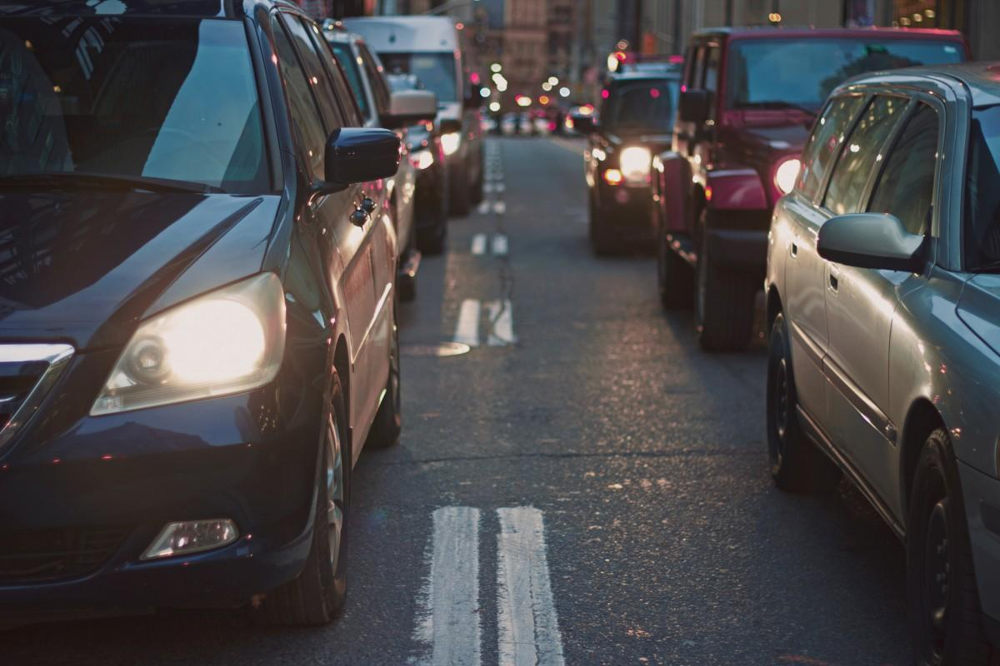

URI: StockImages-cc0/image_1010.jpg - Distance: 1.4046292304992676


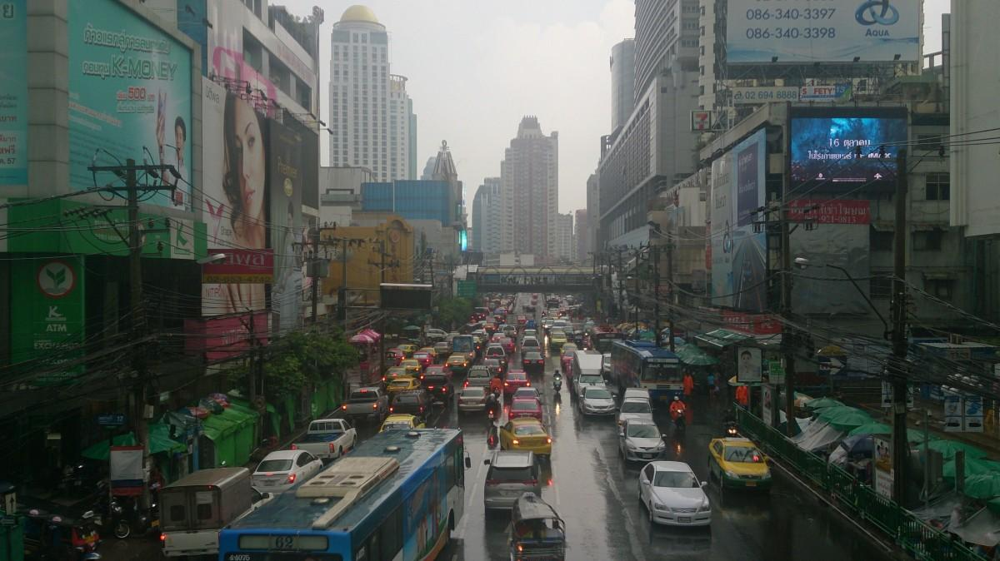

URI: StockImages-cc0/image_68.jpg - Distance: 1.4231518507003784


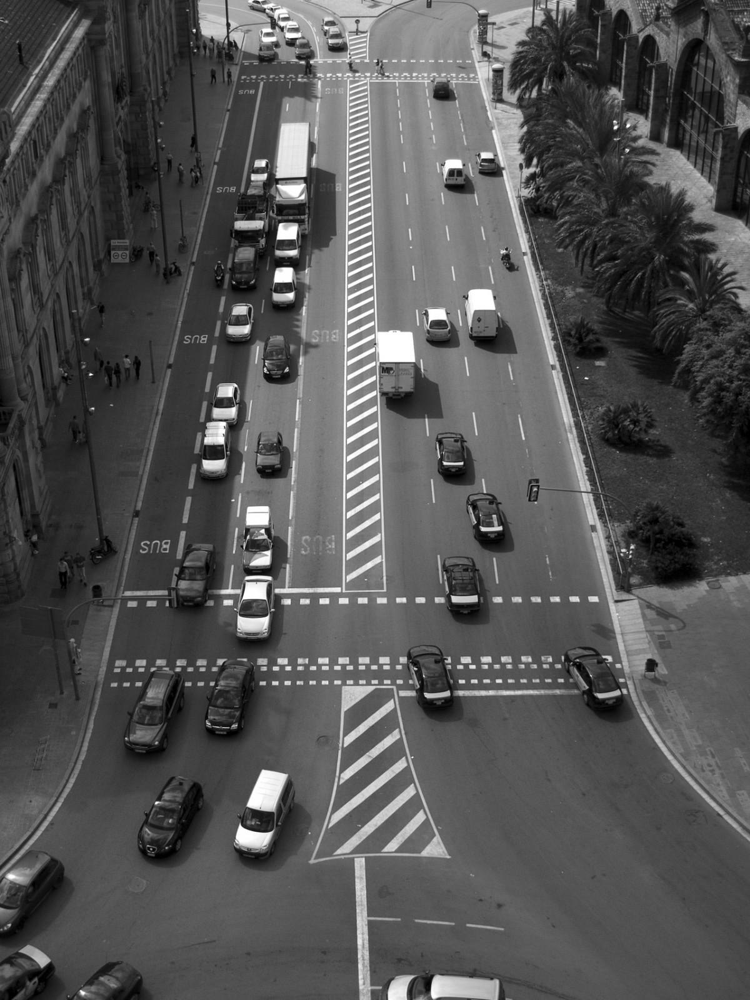

URI: StockImages-cc0/image_241.jpg - Distance: 1.4317704439163208


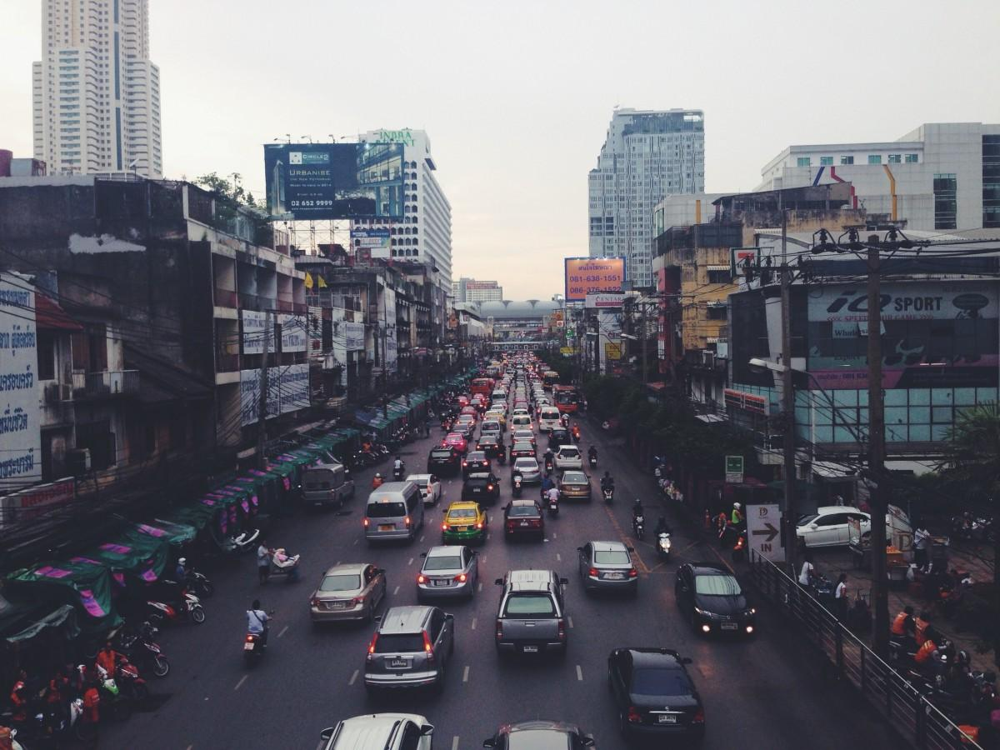

URI: StockImages-cc0/image_3431.jpg - Distance: 1.434969425201416


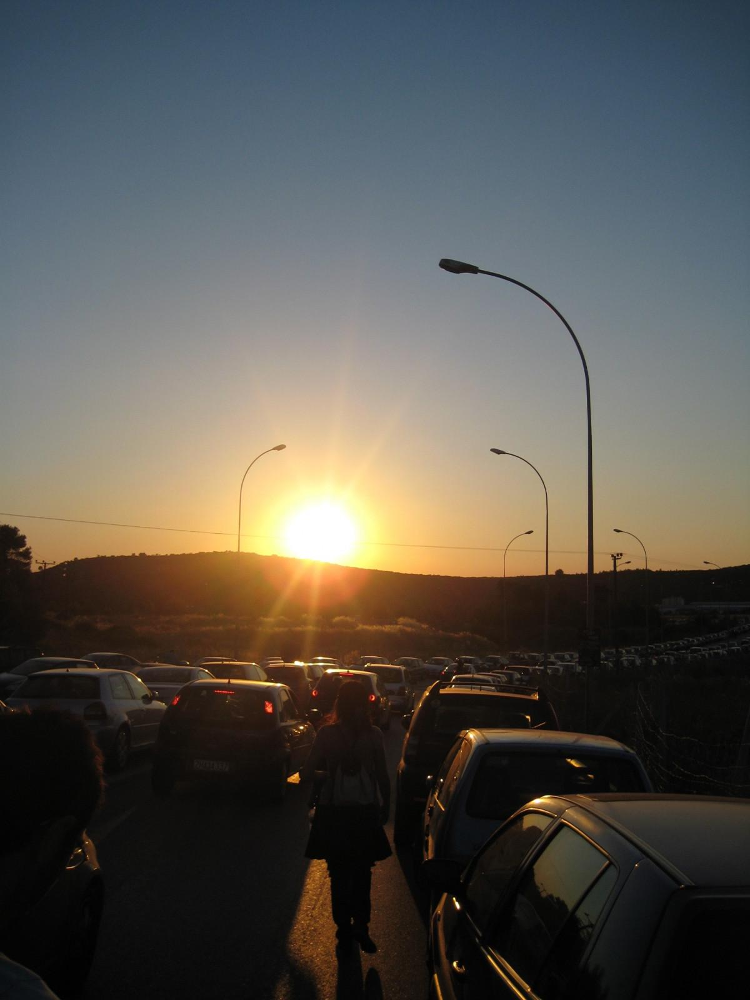

In [ ]:
# Running it
display_images("traffic jam", max_distance=1.5, debug=True)

URI: StockImages-cc0/image_1867.jpg - Distance: 1.3863170146942139


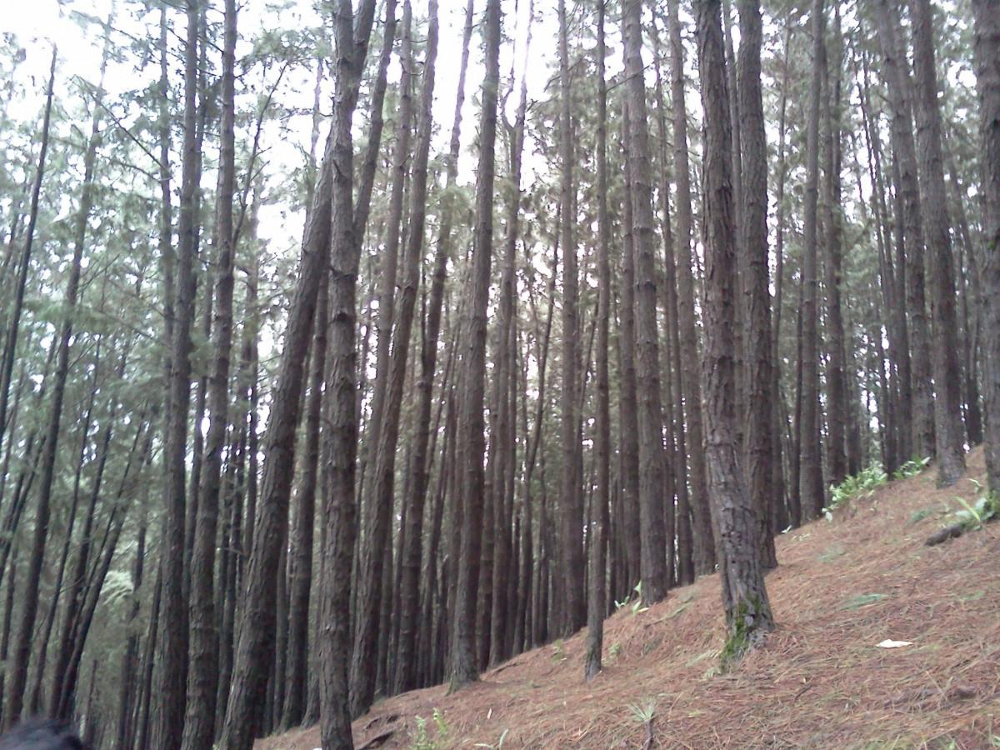

URI: StockImages-cc0/image_2695.jpg - Distance: 1.4075292348861694


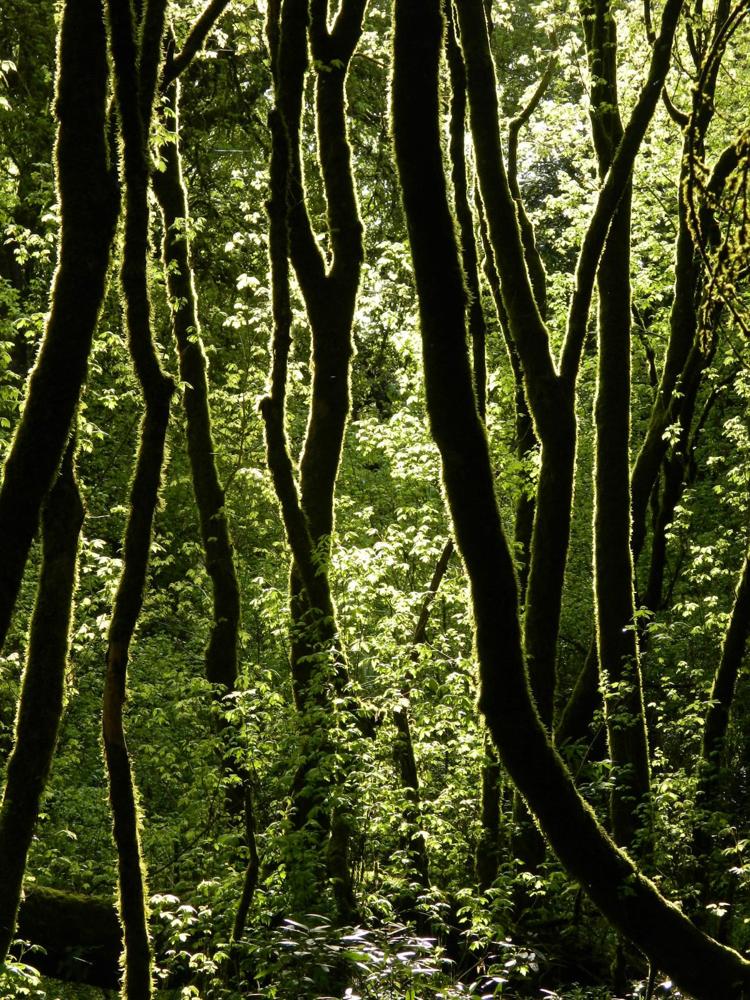

URI: StockImages-cc0/image_2010.jpg - Distance: 1.4250941276550293


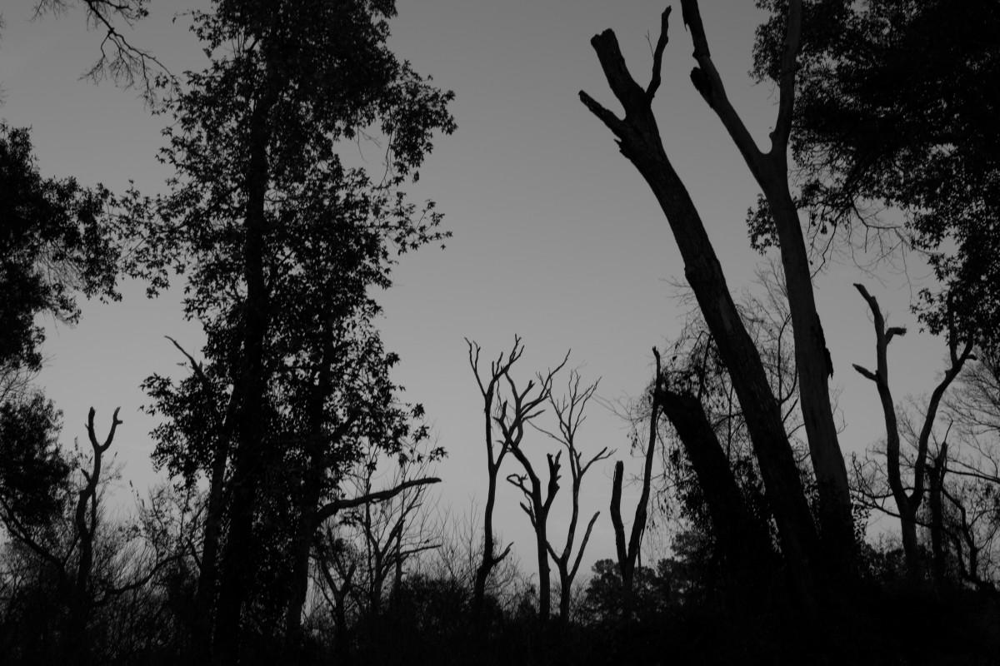

URI: StockImages-cc0/image_608.jpg - Distance: 1.432470440864563


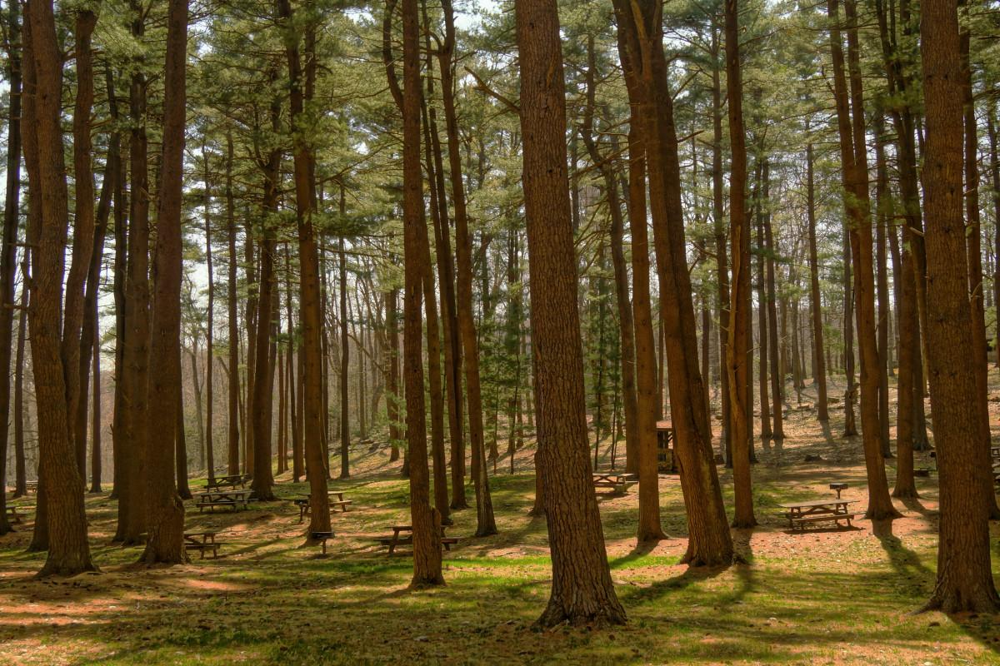

URI: StockImages-cc0/image_127.jpg - Distance: 1.4388651847839355


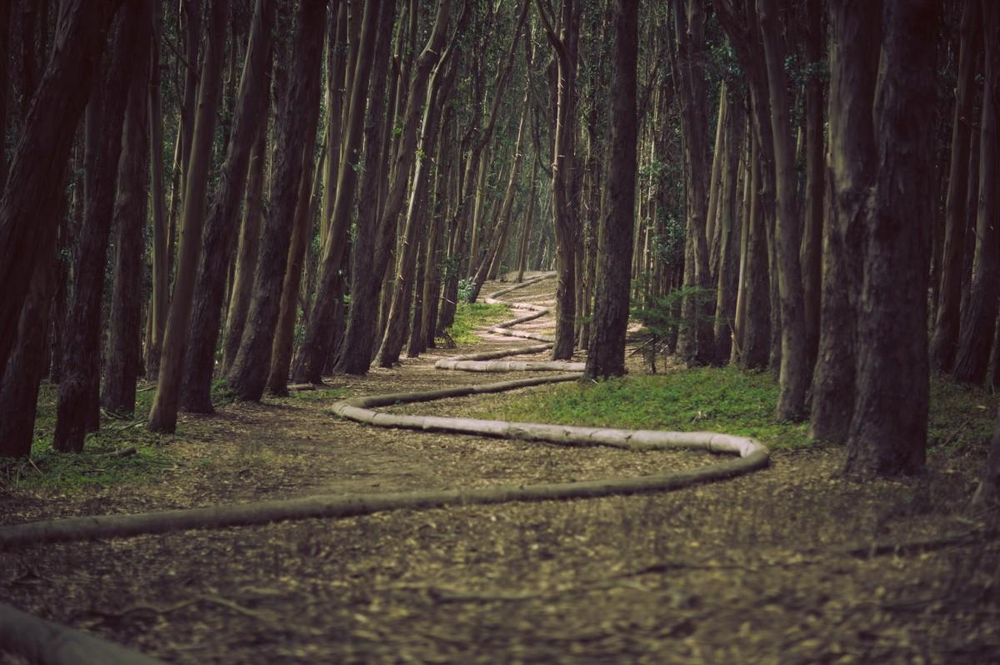

In [ ]:
# Running it
display_images("bosque", max_distance=1.5, debug=True)

URI: StockImages-cc0/image_3837.jpg - Distance: 1.4430274963378906


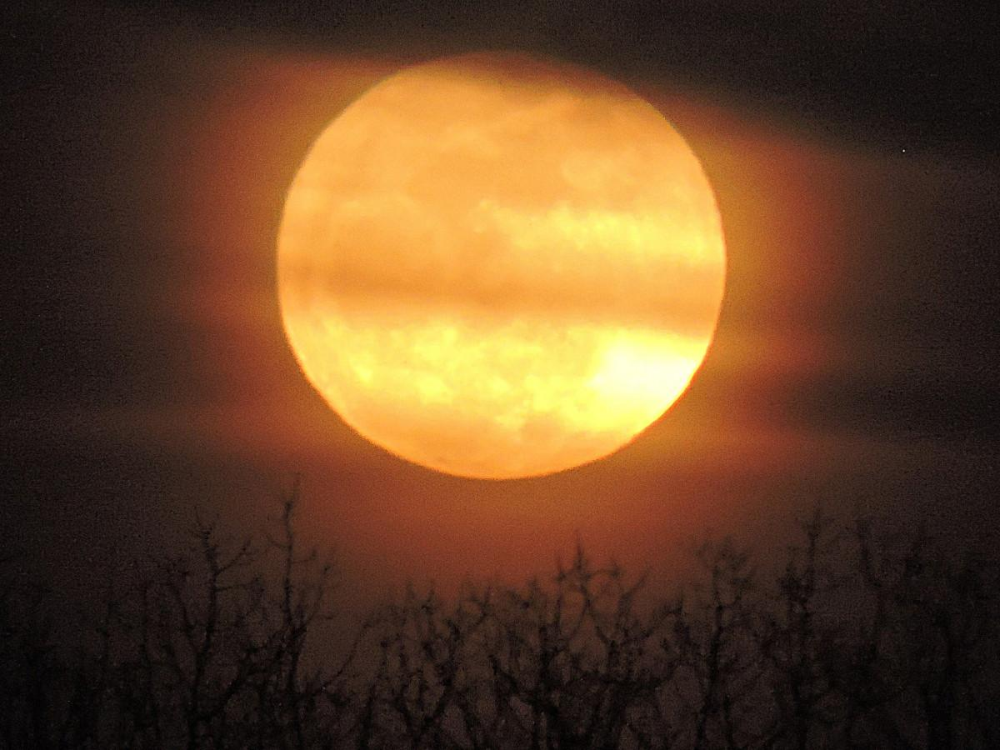

URI: StockImages-cc0/image_3606.jpg - Distance: 1.4448456764221191


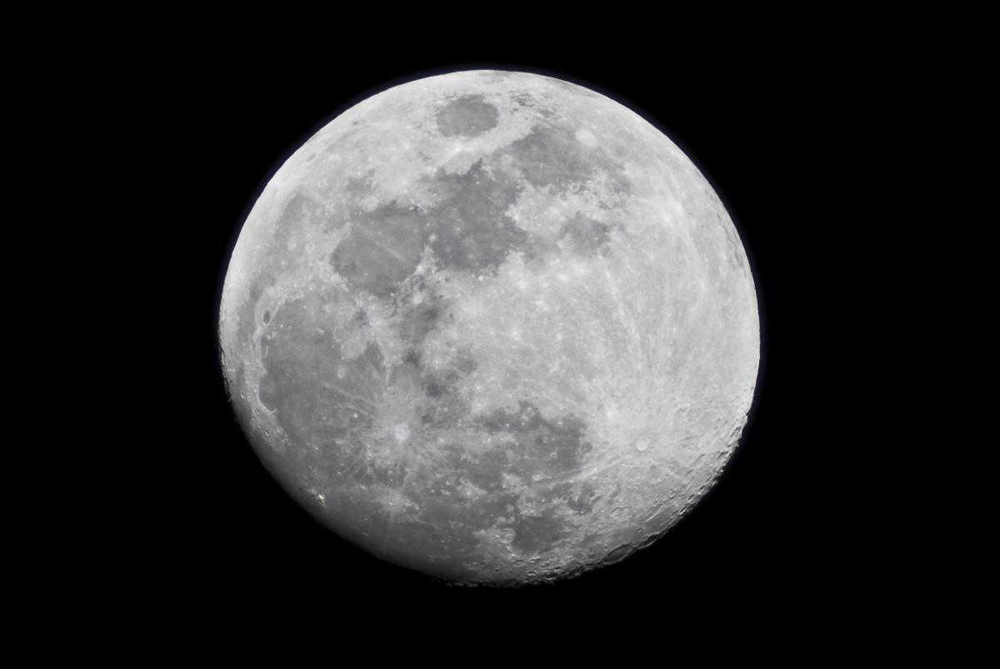

URI: StockImages-cc0/image_2205.jpg - Distance: 1.448870301246643


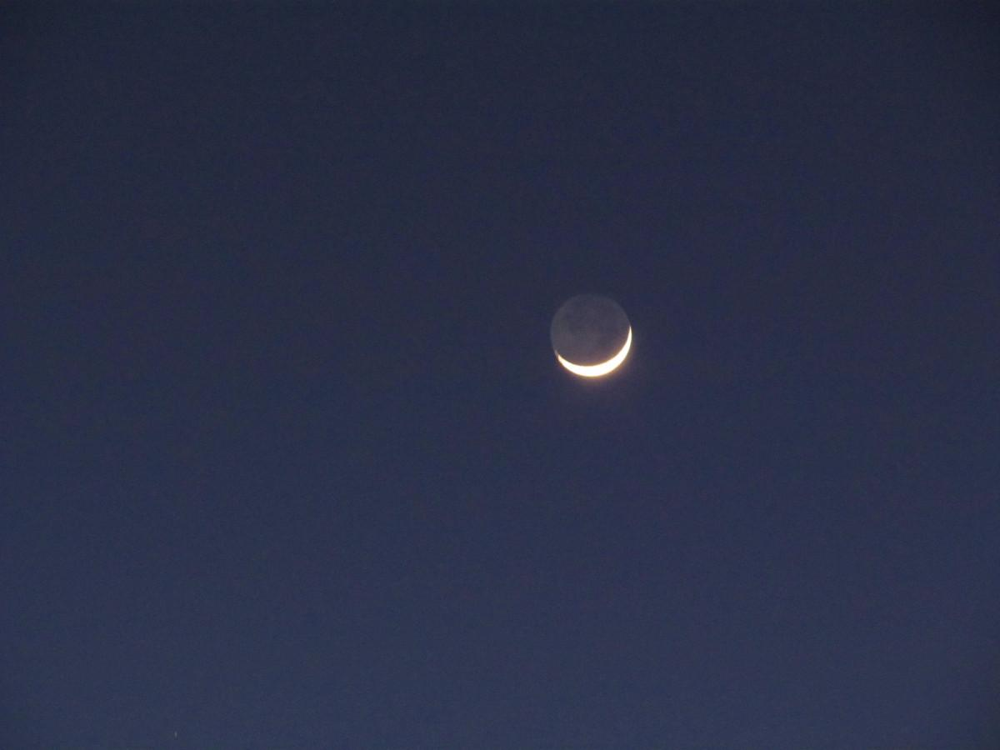

URI: StockImages-cc0/image_1435.jpg - Distance: 1.4511456489562988


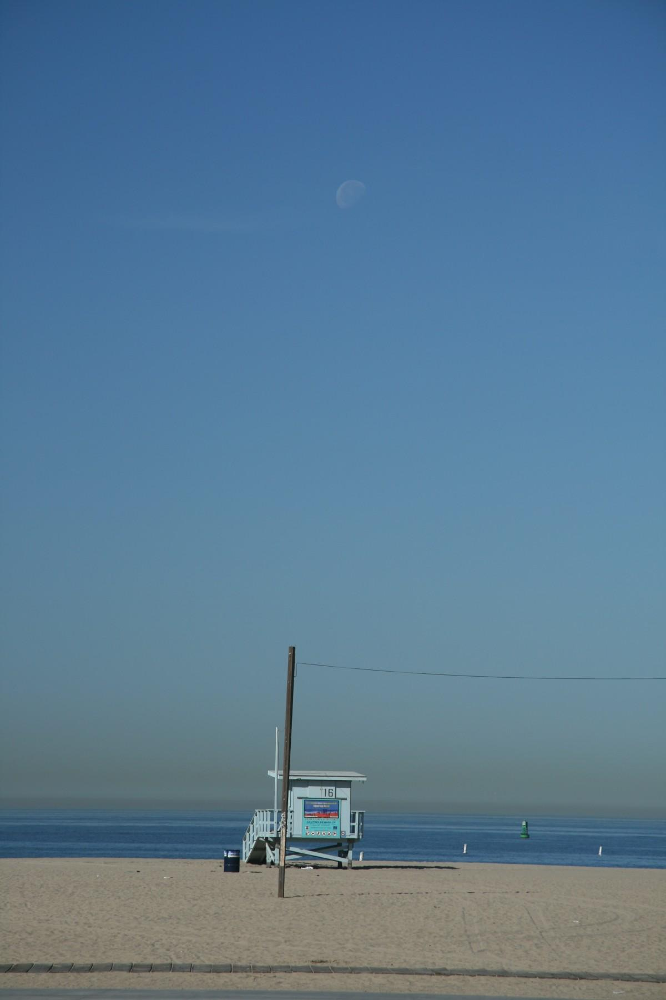

URI: StockImages-cc0/image_3938.jpg - Distance: 1.4540064334869385


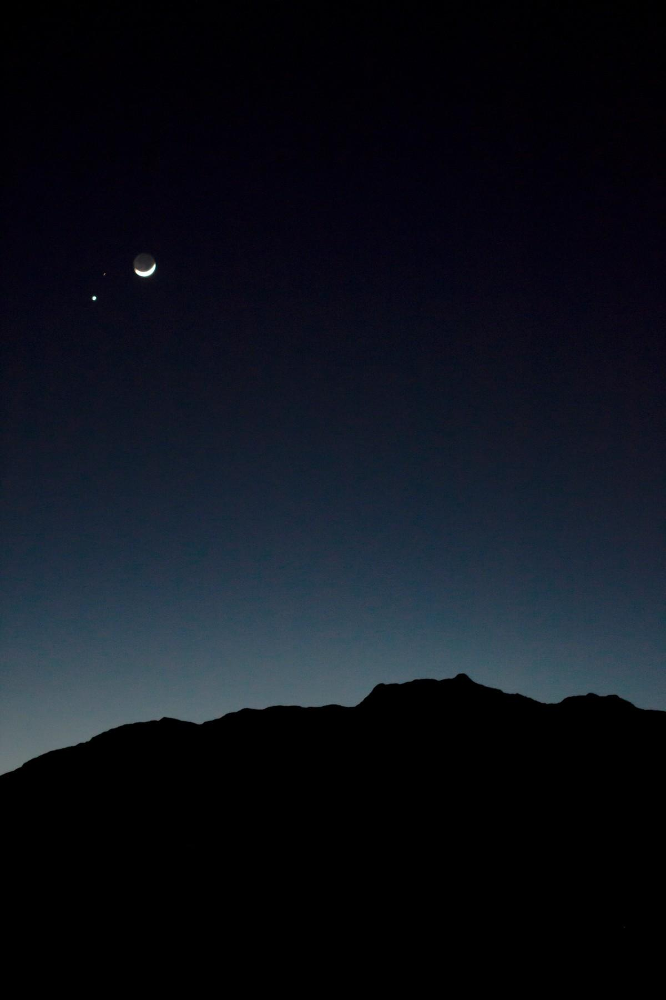

In [ ]:
# Running it
display_images("luna llena", max_distance=1.5, debug=True)

---

# Modality 3: Text Retrieval


## Load the Dataset

 [Wikipedia Example Dataset](https://huggingface.co/datasets/TopicNavi/Wikipedia-example-data)

In [ ]:
ds = load_dataset("TopicNavi/Wikipedia-example-data")

README.md:   0%|          | 0.00/571 [00:00<?, ?B/s]

train-00000-of-00001.parquet:   0%|          | 0.00/135M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/25000 [00:00<?, ? examples/s]

## Pre-processing the data to Speed Things Up

The embedding model [all-MiniLM-L6-v2](https://huggingface.co/sentence-transformers/all-MiniLM-L6-v2)

In [ ]:
# Check if CUDA is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Load the model
model = SentenceTransformer('all-MiniLM-L6-v2').to(device)

# Prepare the data
documents = [entry['text'] for entry in ds['train']]
metadatas = [{"url": entry['url'], "wiki_id": entry['wiki_id']} for entry in ds['train']]
ids = [entry['title'] for entry in ds['train']]

# Generate embeddings
embeddings = []
batch_size = 128  # Adjustable based GPU memory

for i in range(0, len(documents), batch_size):
    batch = documents[i:i+batch_size]
    batch_embeddings = model.encode(batch, convert_to_tensor=True, device=device)
    embeddings.extend(batch_embeddings.cpu().numpy())

# Convert embeddings to list for JSON serialization
embeddings = [emb.tolist() for emb in embeddings]

# Prepare the data for export
export_data = {
    "documents": documents,
    "embeddings": embeddings,
    "metadatas": metadatas,
    "ids": ids
}

# Export
with open('wikipedia_embeddings.json', 'w') as f:
    json.dump(export_data, f)

print("Data exported to wikipedia_embeddings.json")

Using device: cuda


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Data exported to wikipedia_embeddings.json


## Loading From our Saved File to Chroma


In [ ]:
def load_wiki(file_path):
    # Load the JSON data
    with open(file_path, 'r') as f:
        data = json.load(f)

    # Extract the components
    documents = data['documents']
    embeddings = data['embeddings']
    metadatas = data['metadatas']
    ids = data['ids']

    print(f"Loaded data from {file_path}")
    print(f"Number of entries: {len(documents)}")
    print(f"Embedding dimension: {len(embeddings[0])}")

    return documents, embeddings, metadatas, ids

docs, embs, metas, ids = load_wiki('wikipedia_embeddings.json')

Loaded data from wikipedia_embeddings.json
Number of entries: 25000
Embedding dimension: 384


## Creating Text Collection


In [ ]:
text_collection = client.get_or_create_collection(name="text_collection")

## Adding In Text Data to Collection in Batches



In [ ]:
# Batch and add data to the collection, respecting max batch size
def batch_add_to_collection(collection, documents, embeddings, metadatas, ids, batch_size=5461):
    for i in range(0, len(documents), batch_size):
        # Slice the data into batches
        doc_batch = documents[i:i + batch_size]
        emb_batch = embeddings[i:i + batch_size]
        meta_batch = metadatas[i:i + batch_size]
        id_batch = ids[i:i + batch_size]

        # Add the batch to the collection
        collection.add(
            documents=doc_batch,
            embeddings=emb_batch,
            metadatas=meta_batch,
            ids=id_batch
        )
        print(f"Batch {i // batch_size + 1} added to the collection successfully.")

batch_add_to_collection(text_collection, docs, embs, metas, ids)


Batch 1 added to the collection successfully.
Batch 2 added to the collection successfully.
Batch 3 added to the collection successfully.
Batch 4 added to the collection successfully.
Batch 5 added to the collection successfully.


## Testing Function for Text Retrieval


In [ ]:
def display_text_documents(query_text, max_distance=None, debug=False):
    # Query the text collection with the specified text
    results = text_collection.query(
        query_texts=[query_text],
        n_results=5,
        include=['documents', 'distances', 'metadatas']
    )

    documents = results['documents'][0]
    distances = results['distances'][0]
    metadatas = results['metadatas'][0]
    titles = results['ids'][0]

    # Display the text documents that meet the distance criteria or are filtered out
    for title, doc, distance, metadata in zip(titles, documents, distances, metadatas):
        url = metadata.get('url')

        if max_distance is None or distance <= max_distance:
            print(f"Title: {title.replace('_', ' ')}")
            if debug:
              print(f"Distance: {distance}")
            print(f"URL: {url}")
            print(f"Text: {doc}\n")
        else:
            # Output filtered out documents with their title and distance
            if debug:
              print(f"Title: {title.replace('_', ' ')} - Distance: {distance} (Filtered out)")


In [ ]:
# Running it
display_text_documents("univerity", max_distance=1.3, debug=True)

/root/.cache/chroma/onnx_models/all-MiniLM-L6-v2/onnx.tar.gz: 100%|██████████| 79.3M/79.3M [00:07<00:00, 11.9MiB/s]


Title: University
Distance: 0.9029427170753479
URL: https://en.wikipedia.org/wiki?curid=19725260
Text: A university () is an institution of higher (or tertiary) education and research which awards academic degrees in several academic disciplines. Universities typically offer both undergraduate and postgraduate programs. In the United States, the designation is reserved for colleges that have a graduate school.

Title: Alma mater
Distance: 0.9062789082527161
URL: https://en.wikipedia.org/wiki?curid=242819
Text: Alma mater (; pl. [rarely used] ) is an allegorical Latin phrase used to identify a school, college or university that one formerly attended or/and graduated from.

Title: University of Chicago
Distance: 1.053029179573059
URL: https://en.wikipedia.org/wiki?curid=32127
Text: The University of Chicago (UChicago, Chicago, U of C, or UChi) is a private research university in Chicago, Illinois. Its main campus is located in Chicago's Hyde Park neighborhood. The University of Chicago i

In [ ]:
# Running it
display_text_documents("city", max_distance=1.3, debug=True)

Title: City
Distance: 0.9604138135910034
URL: https://en.wikipedia.org/wiki?curid=5391
Text: A city is a human settlement of notable size. It can be defined as a permanent and densely settled place with administratively defined boundaries whose members work primarily on non-agricultural tasks. Cities generally have extensive systems for housing, transportation, sanitation, utilities, land use, production of goods, and communication. Their density facilitates interaction between people, government organisations and businesses, sometimes benefiting different parties in the process, such as improving efficiency of goods and service distribution.

Title: Global city
Distance: 1.0707958936691284
URL: https://en.wikipedia.org/wiki?curid=784781
Text: A global city (also known as a power city, world city, alpha city, or world center) is a city that serves as a primary node in the global economic network. The concept originates from geography and urban studies, based on the thesis that globaliz

In [ ]:
# Running it
display_text_documents("Christmas", max_distance=1.3, debug=True)

Title: Christmas
Distance: 0.8550378084182739
URL: https://en.wikipedia.org/wiki?curid=6237
Text: Christmas is an annual festival commemorating the birth of Jesus Christ, observed primarily on December 25 as a religious and cultural celebration among billions of people around the world. A feast central to the Christian liturgical year, it is preceded by the season of Advent or the Nativity Fast and initiates the season of Christmastide, which historically in the West lasts twelve days and culminates on Twelfth Night. Christmas Day is a public holiday in many countries, is celebrated religiously by a majority of Christians, as well as culturally by many non-Christians, and forms an integral part of the holiday season organized around it.

Title: A Christmas Story
Distance: 1.1071311235427856
URL: https://en.wikipedia.org/wiki?curid=932424
Text: A Christmas Story is a 1983 Christmas comedy film directed by Bob Clark and based on Jean Shepherd's semi-fictional anecdotes in his 1966 book "

----
# Full Multimodal


# Text(s) Retrieved: 


Title: San Francisco
URL: https://en.wikipedia.org/wiki?curid=49728
Text: San Francisco (; Spanish for "Saint Francis"), officially the City and County of San Francisco, is the commercial, financial, and cultural center of Northern California. The city proper is the fourth most populous in California and 17th most populous in the United States, with 815,201 residents as of 2021. It covers a land area of , at the end of the San Francisco Peninsula, making it the second most densely populated large U.S. city after New York City, and the fifth most densely populated U.S. county, behind only four of the five New York City boroughs. Among the 91 U.S. cities proper with over 250,000 residents, San Francisco was ranked first by per capita income (at $160,749) and sixth by aggregate income as of 2021. Colloquial nicknames for San Francisco include "SF", "San Fran", "The ", "Frisco", and "Baghdad by the Bay".

Title: San Francisco 49ers
URL: https://en.wikipedia.org/wiki?curid=27169
Text: The S

# Audio(s) Retrieved: 


# Image(s) Retrieved: 


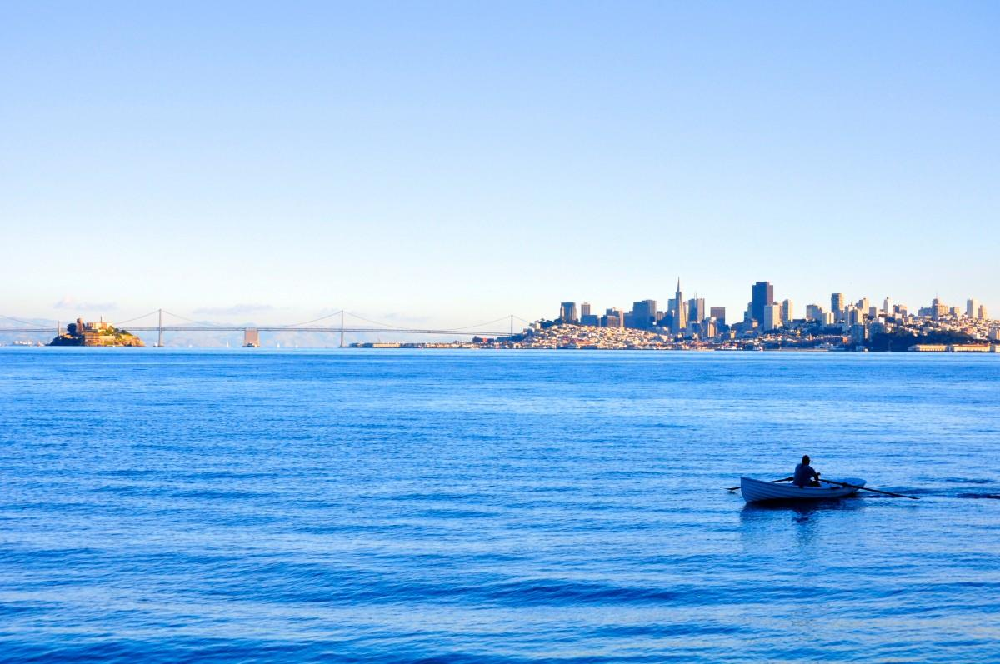

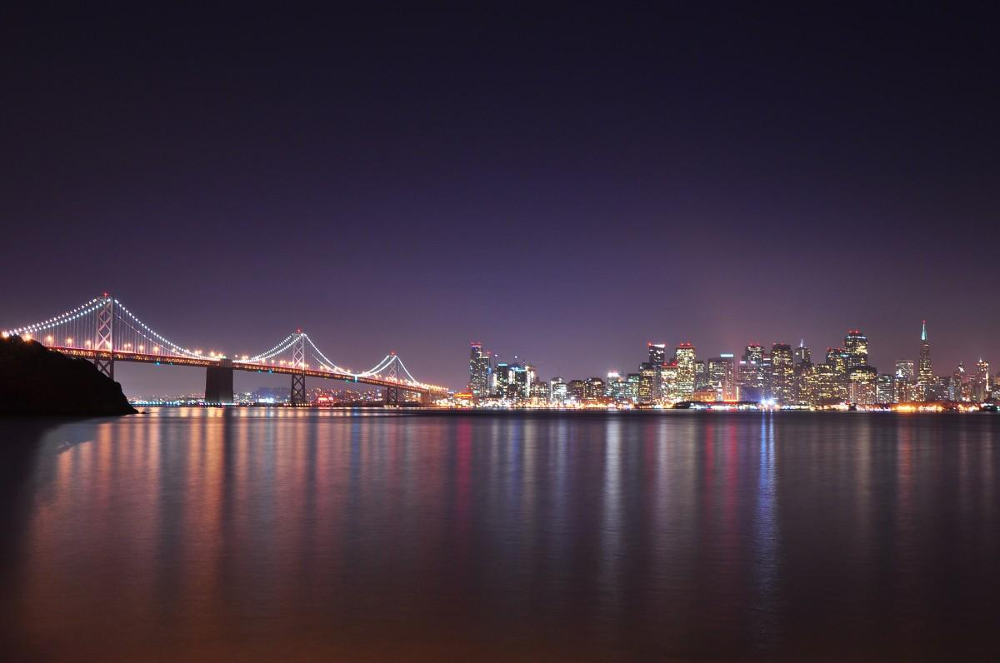

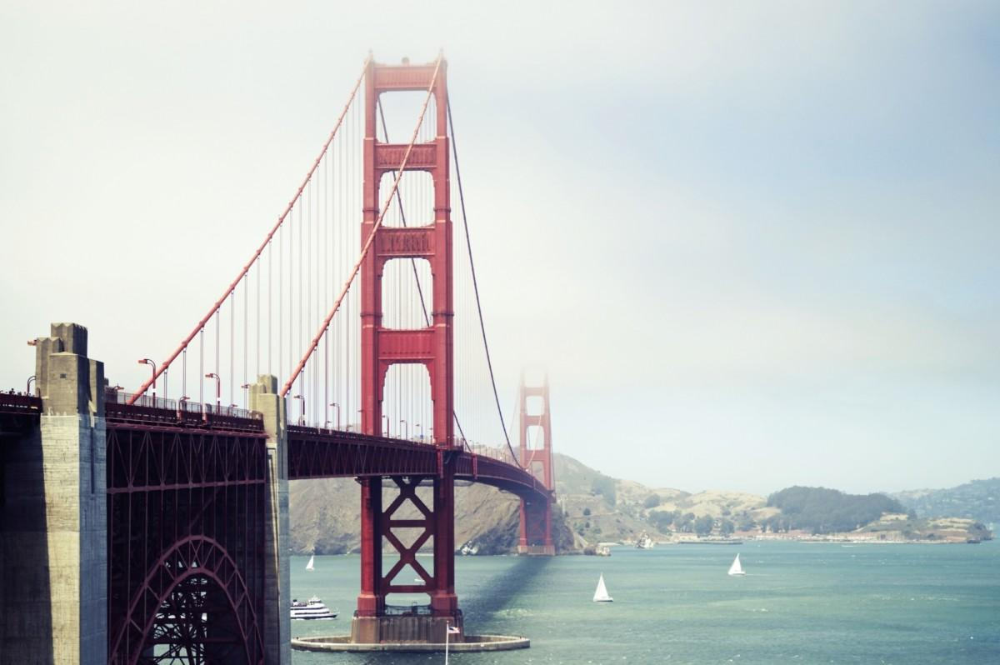

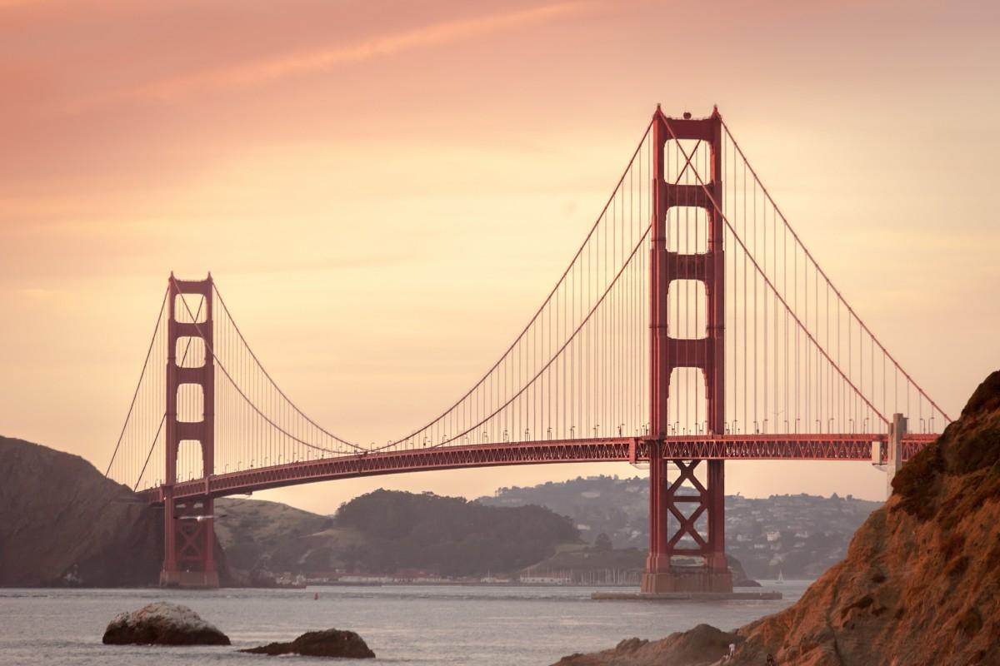

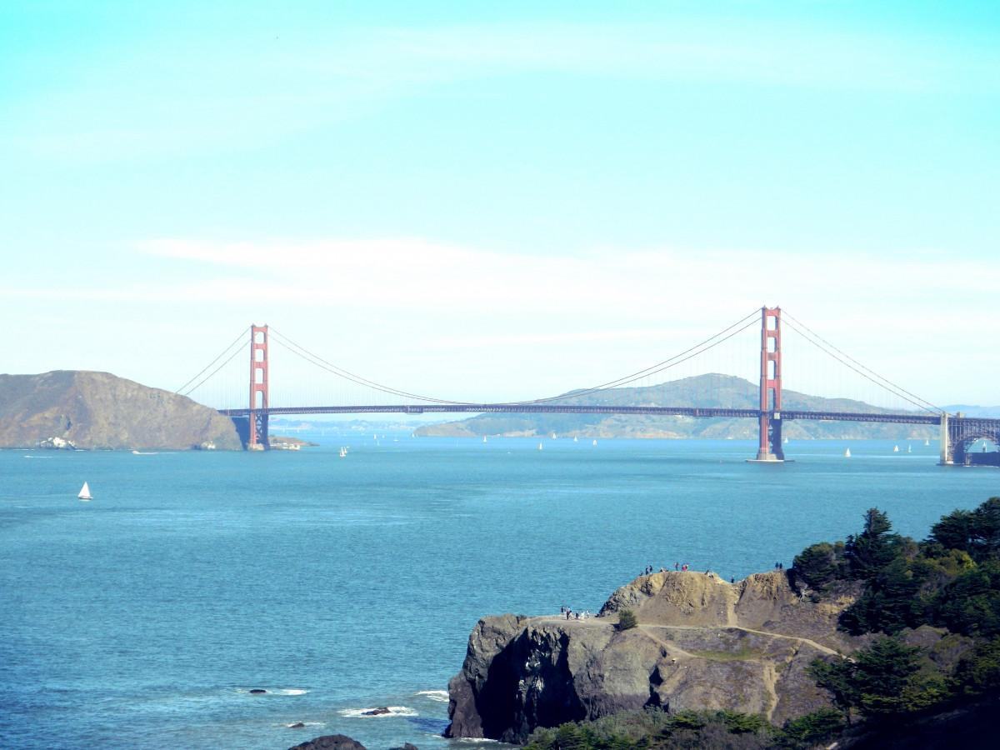

In [ ]:
query = "San Francisco"

display(Markdown("# Text(s) Retrieved: \n"))
display_text_documents(query, max_distance=1.0)

display(Markdown("# Audio(s) Retrieved: \n"))
display_audio_files(query, max_distance=1.2)

display(Markdown("# Image(s) Retrieved: \n"))
display_images(query, max_distance=1.4)


In [3]:
from google.colab import files

uploaded = files.upload()  # Abre un diálogo para seleccionar archivos


Saving qrcode_github.com.png to qrcode_github.com.png


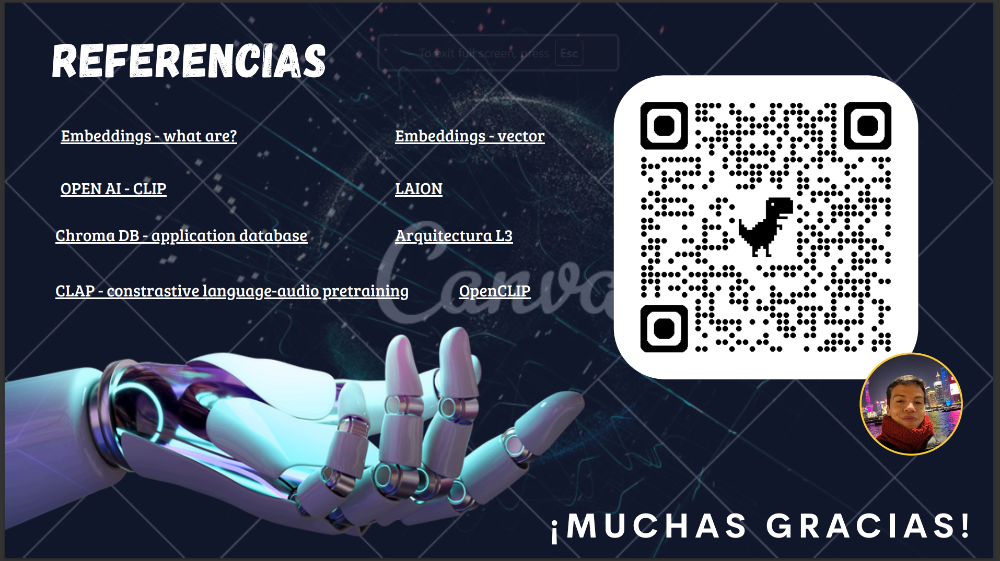

In [3]:
from PIL import Image
from IPython.display import display

img = Image.open("end.png")
display(img)

# **QR repositorio GitHub:**

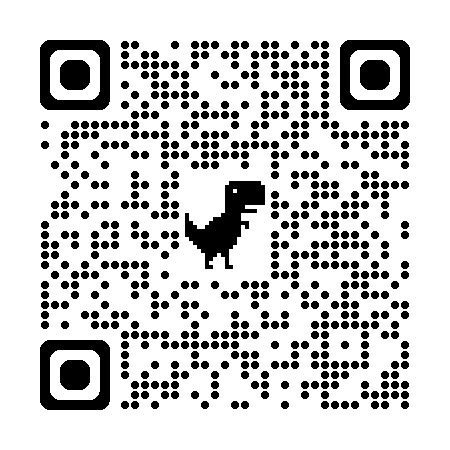

In [4]:
from PIL import Image
from IPython.display import display

img = Image.open("qrcode_github.png")
display(img)